In [1]:
#@title Settings { run: "auto" }

# SETTINGS
proj_width = 7680 #@param {type:"integer"}
proj_height = 1080 #@param {type:"integer"}

bucket = 'lightleaks'
bucket_folder = "todaysart" #@param ["music_center", "todaysart"] {allow-input: true}

LOCAL = True

if LOCAL:
    data_dir = '/home/jovyan/SharedData'
else:
    data_dir = '/tmp/data/'+bucket_folder

In [2]:
# !sudo apt-get -qq install -y libsm6 libxext6 && pip install -q -U opencv-python
# !sudo apt-get install -y libturbojpeg  libxrender-dev
# !pip install jpeg4py msgpack numpy-indexed

# !rm -rf utils
# !git clone https://github.com/kylemcdonald/python-utils utils
import sys

# Utils is added at this path in docker image:
sys.path.append('/home/jovyan/')

import cv2
from utils.imutil import *
from utils.progress import *
# from utils.show_array import *
from matplotlib import pyplot as plt
from itertools import product
import glob 
from scipy import ndimage
from multiprocessing import Pool, cpu_count
from numba import jit


# !pip install mpld3
# import matplotlib.pyplot as plt, mpld3
%matplotlib inline

# mpld3.

In [53]:
folders = [
    'scan-1822',
    'scan-1827',
    'scan-1831',
    'scan-1836',
    'scan-1848',
    'scan-1853',
    'scan-1858',
    'scan-2319',
    'scan-2329',
    'scan-2338',
    'scan-2346',
    'scan-2357',
    'scan-2358'
]

def overflow_fix(proMap):
    proMap[(proMap[:,0] >= proj_width) | (proMap[:,1] >= proj_height)] = [0,0]

# rows, cols = camHeight, camWidth
# confidence.shape: rows, cols (float)
# proMap.shape: rows, cols, 2 (int)
# xyzMap.shape: rows, cols, 3 (float)
def pack_maps(confidence, proMap, xyzMap):
    # prepare confidenceFlat
    confidenceFlat = confidence.reshape(-1,1)
    
    # prepare proMapFlat
    proMapFlat = proMap.reshape(( -1, 2))
    overflow_fix(proMapFlat)
    proMapFlat = np.ravel_multi_index(proMapFlat.transpose()[::-1], (proj_height, proj_width)).reshape(-1,1)
    
    # prepare xyzMapFlat
    scale = len(proMap) / len(xyzMap)
    xyzMap = upsample(xyzMap, scale=scale)
    xyzMapFlat = xyzMap.reshape(-1, 3)
    
    # stack and return everything in shape: (rows x cols), 5
    return np.hstack((confidenceFlat, proMapFlat, xyzMapFlat))

def dedupe(packed):
    # get indices sorted by confidence, use ::-1 to put max confidence first
    packedSortedIndices = packed[:,0].argsort()[::-1]
    packedSorted = packed[packedSortedIndices]
    # get unique packedSorted indices
    _, indices = np.unique(packedSorted.transpose()[1], return_index=True)
    return packedSorted[indices]
    
deduped = None
for folder in folders:
    print(folder)
    confidence = imread(os.path.join(data_dir, folder, 'camConfidence-python.exr'))
    proMap = np.load(os.path.join(data_dir, folder, 'camBinary-python.npy'))
    xyzMap = imread(os.path.join(data_dir, folder, 'xyzMap.exr'))
    packed = pack_maps(confidence, proMap, xyzMap)
    print('packed before:', packed.shape)
    if deduped is not None:
        print('deduped before:', deduped.shape)
        packed = np.vstack((packed, deduped))
        print('packed after:', packed.shape)
    deduped = dedupe(packed)
    print('deduped after:', deduped.shape)

print('hallelujah')

scan-1822
packed before: (17915904, 5)
deduped after: (2780590, 5)
scan-1827
packed before: (17915904, 5)
deduped before: (2780590, 5)
packed after: (20696494, 5)
deduped after: (4015159, 5)
scan-1831
packed before: (17915904, 5)
deduped before: (4015159, 5)
packed after: (21931063, 5)
deduped after: (4862522, 5)
scan-1836
packed before: (17915904, 5)
deduped before: (4862522, 5)
packed after: (22778426, 5)
deduped after: (5396901, 5)
scan-1848
packed before: (17915904, 5)
deduped before: (5396901, 5)
packed after: (23312805, 5)
deduped after: (5788519, 5)
scan-1853
packed before: (17915904, 5)
deduped before: (5788519, 5)
packed after: (23704423, 5)
deduped after: (6091492, 5)
scan-1858
packed before: (17915904, 5)
deduped before: (6091492, 5)
packed after: (24007396, 5)
deduped after: (6371266, 5)
scan-2319
packed before: (17915904, 5)
deduped before: (6371266, 5)
packed after: (24287170, 5)
deduped after: (6542831, 5)
scan-2329
packed before: (17915904, 5)
deduped before: (6542831, 

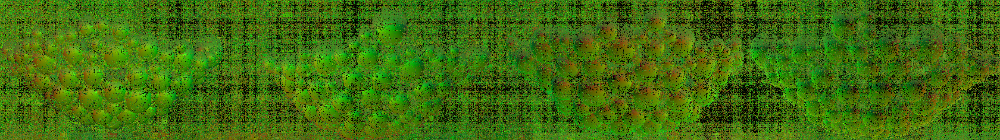

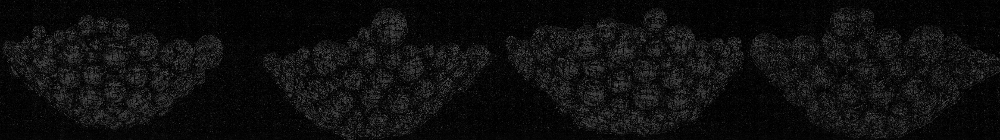

In [54]:
def unpack_maps(packed):
    proXyzMap = np.zeros((proj_height, proj_width, 3))
    proConfidence = np.zeros((proj_height, proj_width, 1))
    
    # assign xyzMap values use proMapFlat indices
    proMapFlat = packed[:,1].astype(np.int32)
    proXyzMap.reshape(-1, 3)[proMapFlat] = packed[:,2:]
    proConfidence.reshape(-1)[proMapFlat] = packed[:,0]
    
    return proXyzMap, proConfidence

proXyzMap, proConfidence = unpack_maps(deduped)
imshow(proXyzMap*255)
imshow(proConfidence*255)

In [55]:
projMask = imread(os.path.join(data_dir, 'mask-0.png')).mean(axis=2) / 255
proConfidenceMasked = proConfidence * projMask[:,:,np.newaxis]
imwrite('../SharedData/confidenceMap-0.exr', proConfidenceMasked.astype(np.float32))
imwrite('../SharedData/xyzMap-0.exr', proXyzMap.astype(np.float32))

True